In [100]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pprint import pprint
import plotly.express as px

In [101]:
train_data = pd.read_csv('TrainingWiDS2021.csv')
test_data = pd.read_csv('UnlabeledWiDS2021.csv')
#set the df to display maximum columns
pd.set_option('display.max_columns',None)

In [102]:
print(train_data.shape)
print(test_data.shape)

(130157, 181)
(10234, 180)


In [103]:
# checking which columns have unique values
temp = (train_data.nunique() == 1)
temp = temp[temp]
print(temp)

readmission_status    True
dtype: bool


In [104]:
#dropping constant value columns
train_data.drop(columns = ['readmission_status','Unnamed: 0','encounter_id','hospital_id','icu_id'], inplace = True)

In [105]:
# 170 numerical fields 
train_data.describe().shape

(8, 170)

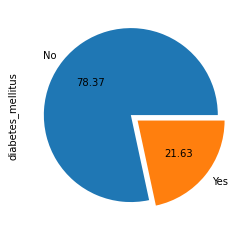

In [106]:
# imbalanced
y_col = 'diabetes_mellitus'
train_data[y_col].value_counts().plot(kind="pie", explode=[0,0.1], autopct="%.2f", labels=["No","Yes"])
plt.show()

### Numerical Features

In [107]:
# col names for numerical features and verifying num cols
num_features = [feature for feature in train_data.columns if train_data[feature].dtype != 'O']
train_data[num_features].shape

(130157, 170)

In [108]:
#separating binary and other numerical features
binary_features = [feature for feature in num_features if train_data[feature].nunique() == 2]
train_data[binary_features].shape

(130157, 14)

In [109]:
# commenting out since Preeya is going to look at these
# for feature in binary_features:
#     pprint(pd.crosstab(train_data[y_col], train_data[feature]))

In [110]:
cont_features = [feature for feature in num_features if feature not in binary_features]
# train_data[cont_features].shape

In [111]:
# list(train_data[cont_features].isna().sum().index)

In [112]:
# # to look at numerical var dist (non binary)
# import os

# if not os.path.exists("num_hist_image"):
#     os.mkdir("num_hist_image") 
    
# for feature in cont_features:
#     fig = px.histogram(train_data, x=feature, color=y_col,marginal="box",title='Distribution %s Over diabetes mellitus'%feature,
#                    opacity=.6,color_discrete_sequence=['#FFA500','#008000'])
#     fig.show()
#     fig.write_image(r"num_hist_image/%s_by_%s_hist.png"%(feature,y_col))

In [113]:
# dropping columns that are over 50% missing
missingness_dict = dict()
for var in train_data.columns:
    mp = train_data[var].isna().sum()/train_data[var].shape[0]*100
    missingness_dict[var] = mp

cols_to_keep = [col for col in cont_features if missingness_dict[col] <= 50]
# number of columns dropped
print("no. of cols dropped : ")
print(len(cont_features) - len(cols_to_keep))
print("new no. of numerical cols : ")
print(len(cols_to_keep))
# var = 'd1_creatinine_min'
# print(train_data[var].shape)
# print(train_data[var].isna().sum())
# train_data[var].isna().sum()/train_data[var].shape[0]*100

no. of cols dropped : 
73
new no. of numerical cols : 
83


In [114]:
# for col in cols_to_keep:
#     print(col)
#     print(missingness_dict[col])

In [115]:
# vars which might be imputed by grouping by categorical vars like gender along with age - 
# bmi, height,weight
median_impute_cols = [col for col in cols_to_keep if col not in ['bmi','height','weight']]
# sub-dataframe with only filtered out numerical non-binary cols
train_data_sub = train_data[cols_to_keep]
for col in median_impute_cols:
    train_data_sub[col].fillna(train_data_sub[col].median(), inplace = True)
    

C:\Users\RBALIGA\Anaconda3\lib\site-packages\pandas\core\series.py:4517: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [116]:
# # validating
# missingness_dict = dict()
# for var in train_data_sub.columns:
#     mp = train_data_sub[var].isna().sum()/train_data_sub[var].shape[0]*100
#     missingness_dict[var] = mp
# missingness_dict

In [117]:
cat_vars = train_data.select_dtypes(include=['object'])
cat_vars

,ethnicity,gender,hospital_admit_source,icu_admit_source,icu_stay_type,icu_type
0,Caucasian,M,Floor,Floor,admit,CTICU
1,Caucasian,F,Floor,Floor,admit,Med-Surg ICU
2,Caucasian,F,Emergency Department,Accident & Emergency,admit,Med-Surg ICU
3,Caucasian,F,Operating Room,Operating Room / Recovery,admit,CTICU
4,Caucasian,M,NaN,Accident & Emergency,admit,Med-Surg ICU
...,...,...,...,...,...,...
130152,Caucasian,M,Emergency Department,Accident & Emergency,admit,Cardiac ICU
130153,Caucasian,F,Direct Admit,Accident & Emergency,admit,MICU
130154,African American,M,Emergency Department,Accident & Emergency,admit,Cardiac ICU
130155,Caucasian,M,Emergency Department,Accident & Emergency,admit,Med-Surg ICU


In [118]:
train_data['gender']

0         M
1         F
2         F
3         F
4         M
         ..
130152    M
130153    F
130154    M
130155    M
130156    M
Name: gender, Length: 130157, dtype: object

In [119]:
#now bmi, height, weight
#def needed for height. Discuss? Can just do median for others
train_data2 = train_data
train_data['gender'] = train_data['gender'].apply(lambda x: 1 if x == 'M' else 0)
for feature in ['bmi','height','weight']:
    fig = px.histogram(train_data, x=feature, color = 'gender', marginal="box",title='Distribution %s Over gender'%feature,
                       opacity=.6,color_discrete_sequence=['#FFA500','#008000'])
    fig.show()
#     fig.write_image(r"num_hist_image/%s_by_%s_hist.png"%(feature,y_col))